In [ ]:
# Today, AI is everywhere, we are able to do many things with it.
# I will be exploring one of the key areas within AI, classification, which is a field currently under research, and we have not fully yet found out the limitations
# We've trained AI which can classify animals, plants, cars, and medicine, among other things.
# However, the main problem in hand revolves around the AI's capability to effectively classify manipulated images and the extent of training required to enable the AI to reliably detect these altered images.
# This is where the AI is most vulnerable as it is not able to adapt quickly to evolving image manipulation techniques and this is what I will be aiming to research and come to a solution where I aim to see how easily I can manipulate the AI into classifying the hacked images.


In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models
import numpy as np
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds
dataset, dataset_info = tfds.load('cats_vs_dogs', split='train', with_info=True, as_supervised=True)
num_classes = 2
num_samples = info.splits['train'].num_examples
img_shape = (64, 64, 3)
def preprocess_image(image, label):
    image = tf.image.resize(image, (img_shape[0], img_shape[1]))
    image = tf.cast(image, tf.float32) / 255.0
    return image, label
train_ds = train_ds.map(preprocess_image)
def build_generator(latent_dim):
    model = models.Sequential()
    model.add(layers.Dense(8 * 8 * 128, input_dim=latent_dim))
    model.add(layers.LeakyReLU())
    model.add(layers.Reshape((8, 8, 128)))
    model.add(layers.Conv2DTranspose(128, kernel_size=4, strides=2, padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Conv2DTranspose(64, kernel_size=4, strides=2, padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Conv2DTranspose(3, kernel_size=4, strides=2, padding='same', activation='tanh'))
    return model
latent_dim = 100
generator = build_generator(latent_dim)
batch_size = 64
epochs = 300
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
for epoch in range(epochs):
    noise = np.random.normal(0, 1, (batch_size, latent_dim))
    generated_images = generator.predict(noise)
    train_images = []
    for image, _ in train_ds.take(batch_size):
        image = tf.image.resize(image, (img_shape[0], img_shape[1]))
        train_images.append(image.numpy())
    train_images = np.array(train_images)
    real_labels = np.ones((batch_size, 1))
    with tf.GradientTape() as tape:
        generated_images = generator(noise)
        d_output_generated = discriminator(generated_images)
        loss_value = tf.keras.losses.binary_crossentropy(valid_labels, d_output_generated)
    gradients = tape.gradient(loss_value, generator.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients, generator.trainable_variables))
    if epoch % 10 == 0:
        print(f"Epoch {epoch}/{epochs} [G loss: {loss_value.numpy()}]")
noise = np.random.normal(0, 1, (16, latent_dim))
generated_images = generator.predict(noise)
plt.figure(figsize=(10, 10))
for i in range(16):
    plt.subplot(4, 4, i + 1)
    plt.imshow((generated_images[i] + 1) / 2)
    plt.axis('off')
plt.show()
#This is my First attempt at a GAN, which I am going to keep as I want to show that it didn't work after a first attempt which was hard due to the GPUs and also training it takes time, however I hope that I am able to combine the GAN and make it work.


RuntimeError: ignored

Streaming output truncated to the last 5000 lines.
1/1 [==============================] - 0s 91ms/step


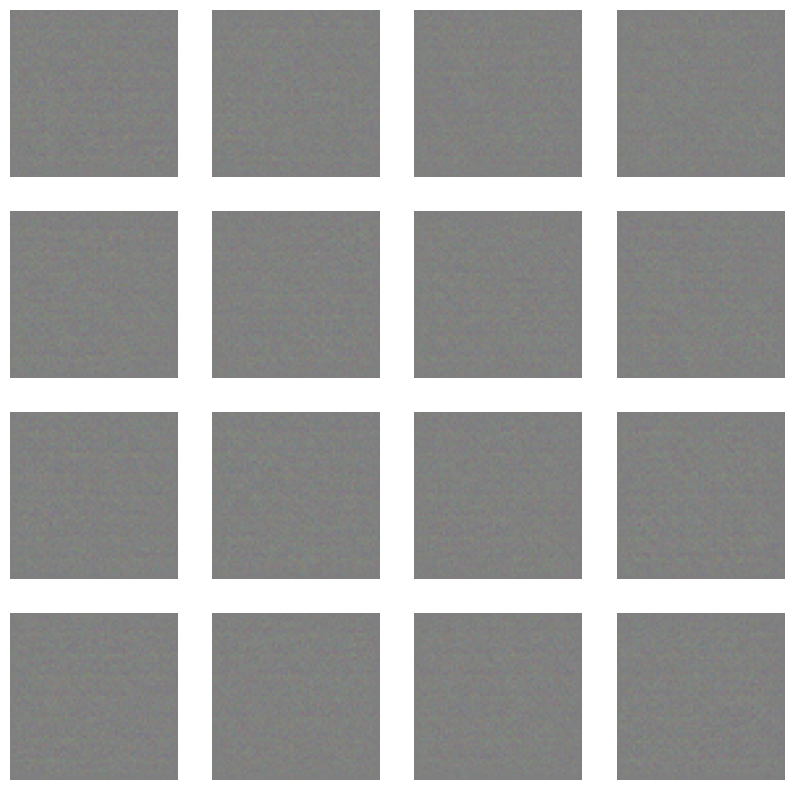

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models
import numpy as np
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds
from art.attacks.evasion import FastGradientMethod
from art.estimators.classification import TensorFlowV2Classifier
tf.compat.v1.enable_eager_execution()
dataset, dataset_info = tfds.load('cats_vs_dogs', split='train', with_info=True, as_supervised=True)
num_classes = 2
img_shape = (64, 64, 3)
def preprocess_image(image, label):
    image = tf.image.resize(image, (img_shape[0], img_shape[1]))
    image = tf.cast(image, tf.float32) / 255.0
    return image, label
train_ds = train_ds.map(preprocess_image)
def build_generator(latent_dim):
    model = models.Sequential()
    model.add(layers.Dense(8 * 8 * 128, input_dim=latent_dim))
    model.add(layers.LeakyReLU())
    model.add(layers.Reshape((8, 8, 128)))
    model.add(layers.Conv2DTranspose(128, kernel_size=4, strides=2, padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Conv2DTranspose(64, kernel_size=4, strides=2, padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Conv2DTranspose(3, kernel_size=4, strides=2, padding='same', activation='tanh'))
    return model
def build_discriminator(img_shape):
    model = models.Sequential()
    model.add(layers.Conv2D(64, kernel_size=4, strides=2, padding='same', input_shape=img_shape))
    model.add(layers.LeakyReLU())
    model.add(layers.Conv2D(128, kernel_size=4, strides=2, padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Flatten())
    model.add(layers.Dense(1, activation='sigmoid'))
    return model
discriminator = build_discriminator(img_shape)
discriminator.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5), metrics=['accuracy'])
latent_dim = 1000
generator = build_generator(latent_dim)
def build_gan(generator, discriminator):
    discriminator.trainable = False
    model = models.Sequential()
    model.add(generator)
    model.add(discriminator)
    return model
discriminator.trainable = False
gan = build_gan(generator, discriminator)
gan.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5))
art_discriminator = TensorFlowV2Classifier(
    model=discriminator,
    nb_classes=2,
    input_shape=img_shape,
    loss_object=tf.keras.losses.BinaryCrossentropy(),
)
attack = FastGradientMethod(art_discriminator)
batch_size = 64
epochs = 5000
for epoch in range(epochs):
    noise = np.random.normal(0, 1, (batch_size, latent_dim))
    generated_images = generator.predict(noise)
    adv_examples = attack.generate(generated_images)
    real_images, _ = next(iter(train_ds.take(batch_size)))
    real_images = np.concatenate([real_images.numpy() for _ in range(batch_size)])
    real_labels = np.ones((batch_size, 1))
    real_images = np.reshape(real_images, (-1,) + img_shape)
    d_loss_real = discriminator.train_on_batch(real_images, real_labels)
    d_loss_fake = discriminator.train_on_batch(generated_images, np.zeros((batch_size, 1)))
    if epoch % 10 == 0:
        print(f"Epoch {epoch}/{epochs} [D loss: {0.5 * np.add(d_loss_real, d_loss_fake)[0]} | D accuracy: {100 * 0.5 * np.add(d_loss_real, d_loss_fake)[1]}]")
    if epoch % 50 == 0:
        num_display = 5
        plt.figure(figsize=(15, 5 * num_display))
        for i, (image, label) in enumerate(train_ds.take(num_display)):
            plt.subplot(num_display, 3, i * 3 + 1)
            plt.imshow(image.numpy())
            plt.title(f'Clean: True Class {label.numpy()}')
            plt.subplot(num_display, 3, i * 3 + 2)
            gen_img = (generated_images[i] + 1) / 2
            plt.imshow(gen_img)
            plt.title(f'GAN-Generated')
            plt.subplot(num_display, 3, i * 3 + 3)
            adv_img = (adv_examples[i] + 1) / 2
            plt.imshow(adv_img)
            plt.title(f'ART-Generated Adversarial')
        plt.show(
noise = np.random.normal(0, 1, (16, latent_dim))
generated_images = generator.predict(noise)

plt.figure(figsize=(10, 10))
for i in range(16):
    plt.subplot(4, 4, i + 1)
    plt.imshow((generated_images[i] + 1) / 2)
    plt.axis('off')
plt.show()

#Here I have created a GAN to show you how it looks like without the ART Library where after 3OO epochs, I am only able to get the grey blocks, I will also add another example with 3OOO epochs which shows the images better but still blurry.

2/2 [==============================] - 0s 5ms/step
Epoch 0/3000 [D loss: 0.6831405162811279 | D accuracy: 45.3125] [G loss: 0.69195556640625]
2/2 [==============================] - 0s 5ms/step
Epoch 10/3000 [D loss: 0.4763753339648247 | D accuracy: 50.0] [G loss: 0.5904911160469055]
2/2 [==============================] - 0s 8ms/step
Epoch 20/3000 [D loss: 0.6164461672306061 | D accuracy: 50.0] [G loss: 0.6287691593170166]
2/2 [==============================] - 0s 5ms/step
Epoch 30/3000 [D loss: 0.46005532145500183 | D accuracy: 95.3125] [G loss: 1.0372810363769531]
2/2 [==============================] - 0s 6ms/step
Epoch 40/3000 [D loss: 0.4488685429096222 | D accuracy: 91.40625] [G loss: 1.0250978469848633]
2/2 [==============================] - 0s 5ms/step
Epoch 50/3000 [D loss: 0.37652213126420975 | D accuracy: 94.53125] [G loss: 0.9646077752113342]
2/2 [==============================] - 0s 6ms/step
Epoch 60/3000 [D loss: 0.2906341627240181 | D accuracy: 99.21875] [G loss: 1.5810809

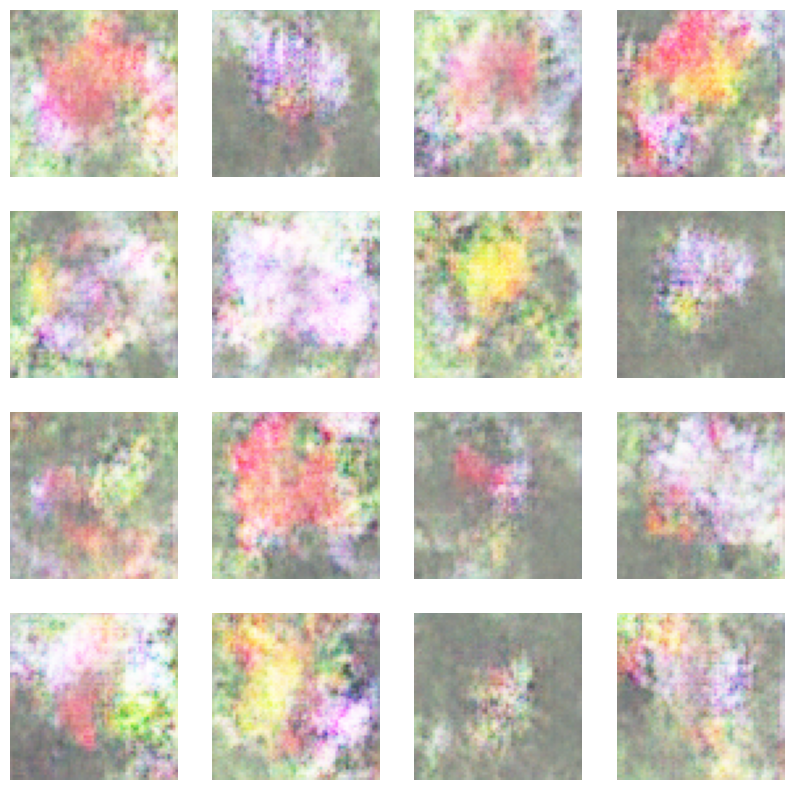

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models
import numpy as np
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds
tf.compat.v1.enable_eager_execution()
dataset, dataset_info = tfds.load('cats_vs_dogs', split='train', with_info=True, as_supervised=True)
num_classes = 2
num_samples = info.splits['train'].num_examples
img_shape = (64, 64, 3)
def preprocess_image(image, label):
    image = tf.image.resize(image, (img_shape[0], img_shape[1]))
    image = tf.cast(image, tf.float32) / 255.0
    return image, label
train_ds = train_ds.map(preprocess_image)
def build_generator(latent_dim):
    model = models.Sequential()
    model.add(layers.Dense(8 * 8 * 128, input_dim=latent_dim))
    model.add(layers.LeakyReLU())
    model.add(layers.Reshape((8, 8, 128)))
    model.add(layers.Conv2DTranspose(128, kernel_size=4, strides=2, padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Conv2DTranspose(64, kernel_size=4, strides=2, padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Conv2DTranspose(3, kernel_size=4, strides=2, padding='same', activation='tanh'))
    return model
def build_discriminator(img_shape):
    model = models.Sequential()
    model.add(layers.Conv2D(64, kernel_size=4, strides=2, padding='same', input_shape=img_shape))
    model.add(layers.LeakyReLU())
    model.add(layers.Conv2D(128, kernel_size=4, strides=2, padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Flatten())
    model.add(layers.Dense(1, activation='sigmoid'))
    return model
discriminator = build_discriminator(img_shape)
discriminator.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.legacy.Adam(learning_rate=0.0002, beta_1=0.5), metrics=['accuracy'])
latent_dim = 100
generator = build_generator(latent_dim)
def build_gan(generator, discriminator):
    discriminator.trainable = False
    model = models.Sequential()
    model.add(generator)
    model.add(discriminator)
    return model
discriminator.trainable = False
gan = build_gan(generator, discriminator)
gan.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.legacy.Adam(learning_rate=0.0002, beta_1=0.5))
batch_size = 64
epochs = 3000
generator_optimizer = tf.keras.optimizers.legacy.Adam(learning_rate=0.0002, beta_1=0.5)
for epoch in range(epochs):
    noise = np.random.normal(0, 1, (batch_size, latent_dim))
    generated_images = generator.predict(noise)
    train_images = []
    for image, _ in train_ds.take(batch_size):
        image = tf.image.resize(image, (img_shape[0], img_shape[1]))
        train_images.append(image.numpy())
    train_images = np.array(train_images)
    real_labels = np.ones((batch_size, 1))
    d_loss_real = discriminator.train_on_batch(train_images, real_labels)
    d_loss_fake = discriminator.train_on_batch(generated_images, np.zeros((batch_size, 1)))
    noise = np.random.normal(0, 1, (batch_size, latent_dim))
    valid_labels = np.ones((batch_size, 1))
    g_loss = gan.train_on_batch(noise, valid_labels)
    if epoch % 10 == 0:
        print(f"Epoch {epoch}/{epochs} [D loss: {0.5 * np.add(d_loss_real, d_loss_fake)[0]} | D accuracy: {100 * 0.5 * np.add(d_loss_real, d_loss_fake)[1]}] [G loss: {g_loss}]")
noise = np.random.normal(0, 1, (16, latent_dim))
generated_images = generator.predict(noise)
plt.figure(figsize=(10, 10))
for i in range(16):
    plt.subplot(4, 4, i + 1)
    plt.imshow((generated_images[i] + 1) / 2)
    plt.axis('off')
plt.show()


Epoch 1/5
582/582 [==============================] - 135s 229ms/step - loss: 0.7542 - accuracy: 0.5220 - val_loss: 0.6928 - val_accuracy: 0.5129
Epoch 2/5
582/582 [==============================] - 154s 264ms/step - loss: 0.6931 - accuracy: 0.5051 - val_loss: 0.6919 - val_accuracy: 0.5593
Epoch 3/5
582/582 [==============================] - 126s 217ms/step - loss: 0.6459 - accuracy: 0.6231 - val_loss: 0.5334 - val_accuracy: 0.7296
Epoch 4/5
582/582 [==============================] - 124s 212ms/step - loss: 0.4931 - accuracy: 0.7631 - val_loss: 0.4657 - val_accuracy: 0.7816
Epoch 5/5
582/582 [==============================] - 123s 212ms/step - loss: 0.4145 - accuracy: 0.8092 - val_loss: 0.4706 - val_accuracy: 0.7859


Number of Adversarial Images: 32


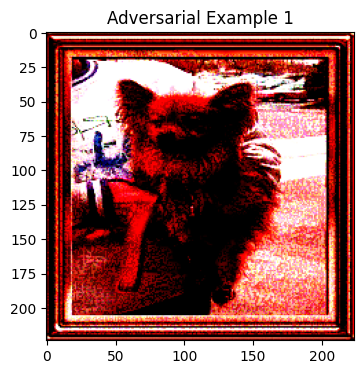

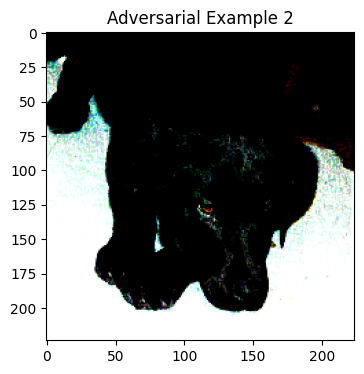

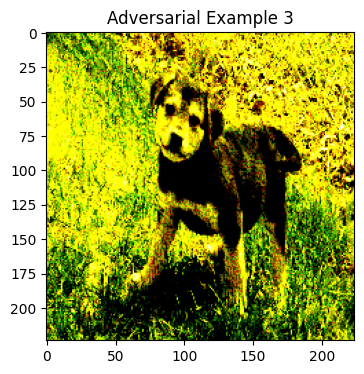

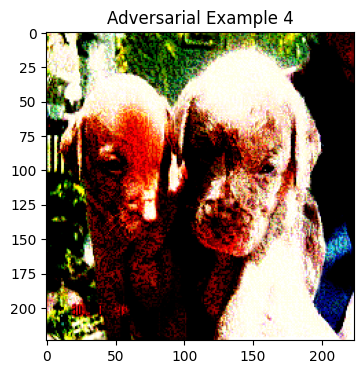

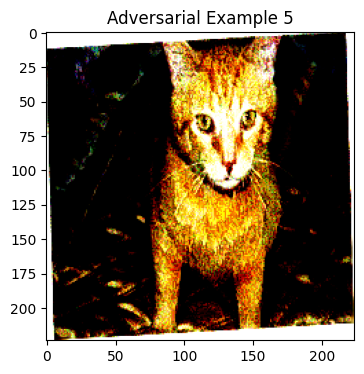

...

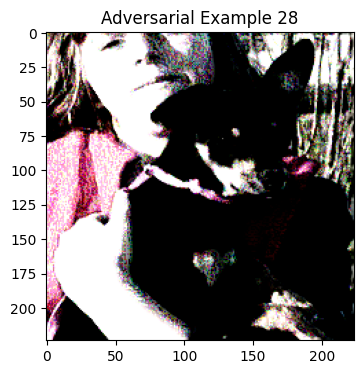

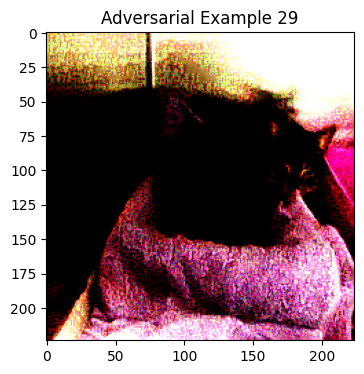

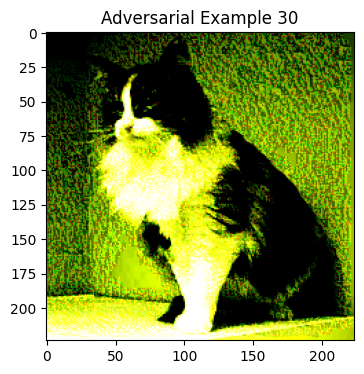

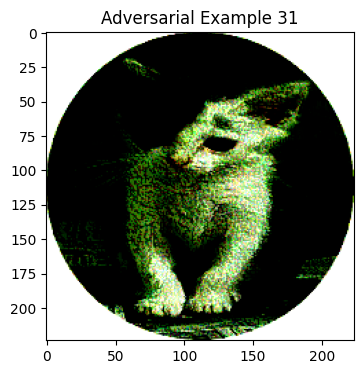

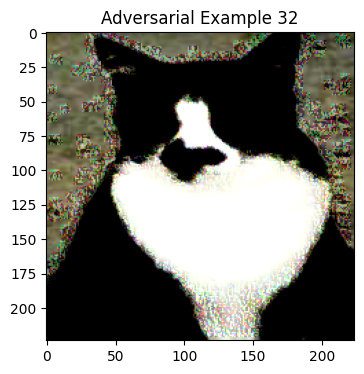

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds
from art.attacks.evasion import FastGradientMethod
from art.estimators.classification import TensorFlowV2Classifier
dataset, dataset_info = tfds.load('cats_vs_dogs', split='train', with_info=True, as_supervised=True)
num_classes = 2
def preprocess_image(image, label):
    image = tf.image.resize(image, (224, 224))
    image = tf.image.random_flip_left_right(image)
    image = tf.image.random_brightness(image, max_delta=0.2)
    image = tf.image.random_contrast(image, lower=0.2, upper=1.8)
    image = tf.image.random_hue(image, max_delta=0.1)
    image = tf.image.random_saturation(image, lower=0.2, upper=1.8)
    image = tf.image.per_image_standardization(image)
    label = tf.one_hot(label, num_classes)
    return image, label
dataset = dataset.map(preprocess_image)
num_samples = dataset_info.splits['train'].num_examples
num_train_samples = int(0.8 * num_samples)
num_val_samples = int(0.1 * num_samples)
num_test_samples = num_samples - num_train_samples - num_val_samples
train_dataset = dataset.take(num_train_samples)
remaining_dataset = dataset.skip(num_train_samples)
val_dataset = remaining_dataset.take(num_val_samples)
test_dataset = remaining_dataset.skip(num_val_samples)
batch_size = 32
train_dataset = train_dataset.batch(batch_size)
val_dataset = val_dataset.batch(batch_size)
test_dataset = test_dataset.batch(batch_size)
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    MaxPooling2D(2, 2),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),
    Flatten(),
    Dense(512, activation='relu'),
    Dense(num_classes, activation='softmax')
])
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model.fit(train_dataset, epochs=5, validation_data=val_dataset)
latent_dim = 100
def build_generator(latent_dim):
    model = Sequential()
    model.add(Dense(256, input_dim=latent_dim, activation='relu'))
    model.add(Dense(512, activation='relu'))
    model.add(Dense(3, activation='tanh'))
    return model
def build_discriminator(img_shape):
    model = Sequential()
    model.add(Flatten(input_shape=img_shape))
    model.add(Dense(512, activation='relu'))
    model.add(Dense(256, activation='relu'))
    model.add(Dense(1, activation='sigmoid'))
    return model
generator = build_generator(latent_dim)
discriminator = build_discriminator((224, 224, 3))
art_classifier = TensorFlowV2Classifier(
    model=model,
    nb_classes=num_classes,
    input_shape=(224, 224, 3),
    loss_object=tf.keras.losses.CategoricalCrossentropy(),
)
attack = FastGradientMethod(estimator=art_classifier, eps=0.2)
test_batch = next(iter(test_dataset))
test_images, test_labels = test_batch
adversarial_test_images = attack.generate(test_images.numpy(), y=test_labels.numpy())
num_adversarial_images = adversarial_test_images.shape[0]
print(f"Number of Adversarial Images: {num_adversarial_images}")
num_display = min(num_adversarial_images, 35)
for i in range(num_display):
    plt.figure(figsize=(8, 4))
    plt.imshow(adversarial_test_images[i])
    plt.title(f'Adversarial Example {i + 1}')
    plt.show()

    #As I mentioned before, I wanted to attempt to Combine both GAN and the Library which really helped my project, here you can see that I have been able to successfully confuse the model, and able to generate the images with different classes.


Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Generating splits...:   0%|          | 0/1 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/23262 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/cats_vs_dogs/4.0.1.incompletePEDBM0/cats_vs_dogs-train.tfrecord*...:   0%|…

Dataset cats_vs_dogs downloaded and prepared to /root/tensorflow_datasets/cats_vs_dogs/4.0.1. Subsequent calls will reuse this data.
Epoch 1/5
582/582 [==============================] - 138s 226ms/step - loss: 0.7131 - accuracy: 0.6020 - val_loss: 0.6017 - val_accuracy: 0.6556
Epoch 2/5
582/582 [==============================] - 149s 257ms/step - loss: 0.5785 - accuracy: 0.6870 - val_loss: 0.5178 - val_accuracy: 0.7442
Epoch 3/5
582/582 [==============================] - 150s 258ms/step - loss: 0.4826 - accuracy: 0.7669 - val_loss: 0.4614 - val_accuracy: 0.7803
Epoch 4/5
582/582 [==============================] - 125s 215ms/step - loss: 0.4036 - accuracy: 0.8175 - val_loss: 0.4657 - val_accuracy: 0.7820
Epoch 5/5
582/582 [==============================] - 150s 258ms/step - loss: 0.3259 - accuracy: 0.8634 - val_loss: 0.4479 - val_accuracy: 0.7966


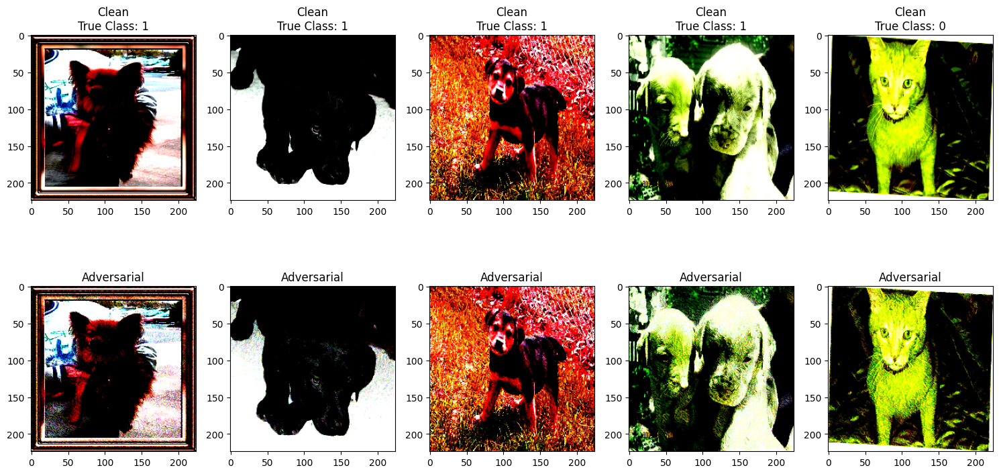

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds
from art.attacks.evasion import FastGradientMethod
from art.estimators.classification import TensorFlowV2Classifier
dataset, dataset_info = tfds.load('cats_vs_dogs', split='train', with_info=True, as_supervised=True)
num_classes = 2
def preprocess_image(image, label):
    image = tf.image.resize(image, (224, 224))
    image = tf.image.random_flip_left_right(image)
    image = tf.image.random_brightness(image, max_delta=0.2)
    image = tf.image.random_contrast(image, lower=0.2, upper=1.8)
    image = tf.image.random_hue(image, max_delta=0.1)
    image = tf.image.random_saturation(image, lower=0.2, upper=1.8)
    image = tf.image.per_image_standardization(image)
    label = tf.one_hot(label, num_classes)
    return image, label
dataset = dataset.map(preprocess_image)
num_samples = dataset_info.splits['train'].num_examples
num_train_samples = int(0.8 * num_samples)
num_val_samples = int(0.1 * num_samples)
num_test_samples = num_samples - num_train_samples - num_val_samples
train_dataset = dataset.take(num_train_samples)
remaining_dataset = dataset.skip(num_train_samples)
val_dataset = remaining_dataset.take(num_val_samples)
test_dataset = remaining_dataset.skip(num_val_samples)
batch_size = 32
train_dataset = train_dataset.batch(batch_size)
val_dataset = val_dataset.batch(batch_size)
test_dataset = test_dataset.batch(batch_size)
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    MaxPooling2D(2, 2),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),
    Flatten(),
    Dense(512, activation='relu'),
    Dense(num_classes, activation='softmax')
])
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model.fit(train_dataset, epochs=5, validation_data=val_dataset)
latent_dim = 100
def build_generator(latent_dim):
    model = Sequential()
    model.add(Dense(256, input_dim=latent_dim, activation='relu'))
    model.add(Dense(512, activation='relu'))
    model.add(Dense(3, activation='tanh'))
    return model
def build_discriminator(img_shape):
    model = Sequential()
    model.add(Flatten(input_shape=img_shape))
    model.add(Dense(512, activation='relu'))
    model.add(Dense(256, activation='relu'))
    model.add(Dense(1, activation='sigmoid'))
    return model
generator = build_generator(latent_dim)
discriminator = build_discriminator((224, 224, 3))
art_classifier = TensorFlowV2Classifier(
    model=model,
    nb_classes=num_classes,
    input_shape=(224, 224, 3),
    loss_object=tf.keras.losses.CategoricalCrossentropy(),
)
attack = FastGradientMethod(estimator=art_classifier, eps=0.2)
test_batch = next(iter(test_dataset))
test_images, test_labels = test_batch
adversarial_test_images = attack.generate(test_images.numpy(), y=test_labels.numpy())
num_display = min(len(test_images), 5)
plt.figure(figsize=(15, 8))
for i in range(num_display):
    plt.subplot(2, num_display, i + 1)
    plt.imshow(test_images[i])
    plt.title(f'Clean\nTrue Class: {np.argmax(test_labels[i])}')
    plt.subplot(2, num_display, num_display + i + 1)
    plt.imshow(adversarial_test_images[i])
    plt.title('Adversarial')

plt.tight_layout()
plt.show()
  #Here we are looking at the original class and also the predicted class using GAN and ART which allowed to combine them both together, we are able to see that it is sucessfully confusing the AI model.



Epoch 1/5
582/582 [==============================] - 132s 221ms/step - loss: 0.7418 - accuracy: 0.5227 - val_loss: 0.6369 - val_accuracy: 0.6324
Epoch 2/5
582/582 [==============================] - 121s 208ms/step - loss: 0.5908 - accuracy: 0.6879 - val_loss: 0.5122 - val_accuracy: 0.7451
Epoch 3/5
582/582 [==============================] - 147s 253ms/step - loss: 0.4712 - accuracy: 0.7772 - val_loss: 0.4626 - val_accuracy: 0.7820
Epoch 4/5
582/582 [==============================] - 120s 206ms/step - loss: 0.3944 - accuracy: 0.8247 - val_loss: 0.4447 - val_accuracy: 0.7954
Epoch 5/5
582/582 [==============================] - 119s 204ms/step - loss: 0.3114 - accuracy: 0.8720 - val_loss: 0.4581 - val_accuracy: 0.8074


Adversarial Test Accuracy: 0.00%


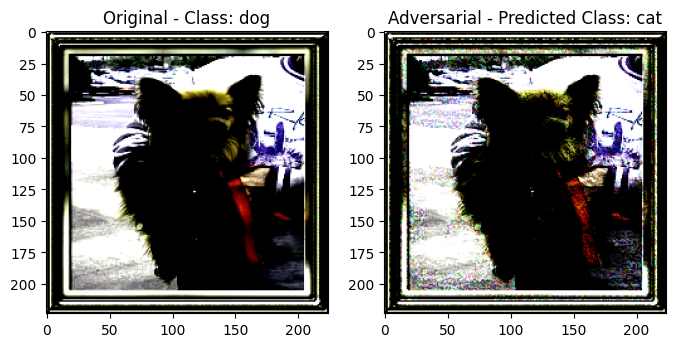

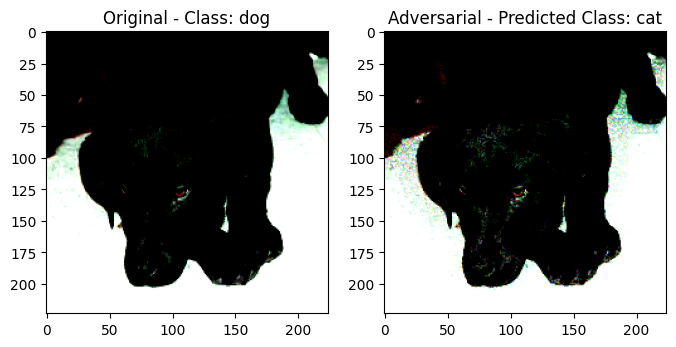

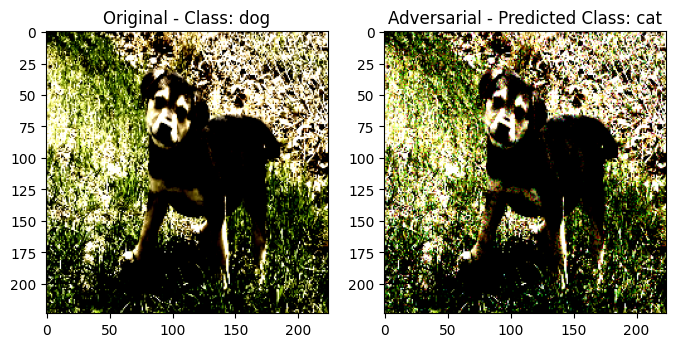

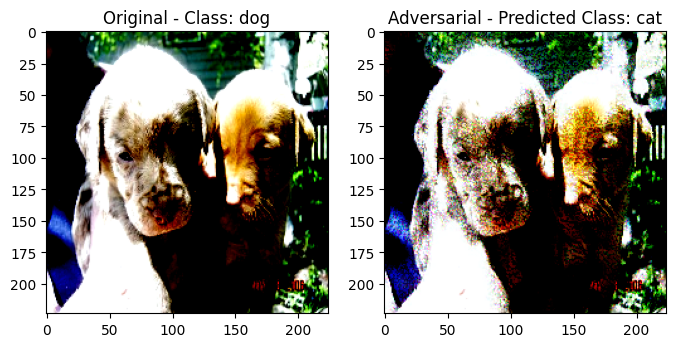

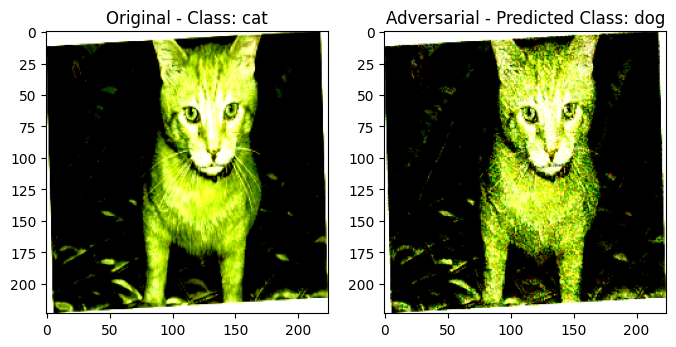

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras import Sequential, layers
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds
from art.attacks.evasion import FastGradientMethod
from art.estimators.classification import TensorFlowV2Classifier
dataset, dataset_info = tfds.load('cats_vs_dogs', split='train', with_info=True, as_supervised=True)
num_classes = 2
def preprocess_image(image, label):
    image = tf.image.resize(image, (224, 224))
    image = tf.image.random_flip_left_right(image)
    image = tf.image.random_brightness(image, max_delta=0.2)
    image = tf.image.random_contrast(image, lower=0.2, upper=1.8)
    image = tf.image.random_hue(image, max_delta=0.1)
    image = tf.image.random_saturation(image, lower=0.2, upper=1.8)
    image = tf.image.per_image_standardization(image)
    label = tf.one_hot(label, num_classes)
    return image, label
dataset = dataset.map(preprocess_image)
num_samples = dataset_info.splits['train'].num_examples
num_train_samples = int(0.8 * num_samples)
num_val_samples = int(0.1 * num_samples)
num_test_samples = num_samples - num_train_samples - num_val_samples
train_dataset = dataset.take(num_train_samples)
remaining_dataset = dataset.skip(num_train_samples)
val_dataset = remaining_dataset.take(num_val_samples)
test_dataset = remaining_dataset.skip(num_val_samples)
batch_size = 32
train_dataset = train_dataset.batch(batch_size)
val_dataset = val_dataset.batch(batch_size)
test_dataset = test_dataset.batch(batch_size)
class_names = dataset_info.features['label'].names
model = Sequential([
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    layers.MaxPooling2D(2, 2),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D(2, 2),
    layers.Conv2D(128, (3, 3), activation='relu'),
    layers.MaxPooling2D(2, 2),
    layers.Flatten(),
    layers.Dense(512, activation='relu'),
    layers.Dense(num_classes, activation='softmax')
])
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
#GAN
model.fit(train_dataset, epochs=5, validation_data=val_dataset)
generator = Sequential([
    layers.Dense(256, activation='relu', input_shape=(100,)),
    layers.Reshape((4, 4, 16)),
    layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', activation='relu'),
    layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', activation='relu'),
    layers.Conv2DTranspose(3, (4, 4), strides=(2, 2), padding='same', activation='sigmoid')
])
discriminator = Sequential([
    layers.Conv2D(64, (3, 3), strides=(2, 2), padding='same', activation='relu', input_shape=(224, 224, 3)),
    layers.Conv2D(128, (3, 3), strides=(2, 2), padding='same', activation='relu'),
    layers.Flatten(),
    layers.Dense(1, activation='sigmoid')
])
discriminator.trainable = False
gan = Sequential([generator, discriminator])
gan.compile(optimizer='adam', loss='binary_crossentropy')
test_batch = next(iter(test_dataset))
test_images, test_labels = test_batch
art_classifier = TensorFlowV2Classifier(
    model=model,
    nb_classes=num_classes,
    input_shape=(224, 224, 3),
    loss_object=tf.keras.losses.CategoricalCrossentropy(),
)
attack = FastGradientMethod(estimator=art_classifier, eps=0.2)
adversarial_test_images = attack.generate(test_images.numpy(), y=test_labels.numpy())
num_adversarial_images = adversarial_test_images.shape[0]
print(f"Number of Adversarial Images: {num_adversarial_images}")
num_display = min(num_adversarial_images, 5)
for i in range(num_display):
    plt.figure(figsize=(8, 4))
    plt.subplot(1, 2, 1)
    plt.imshow(test_images[i])
    plt.title(f'Original - Class: {class_names[test_labels[i].numpy()]}')
    plt.subplot(1, 2, 2)
    plt.imshow(adversarial_test_images[i])
    plt.title(f'Adversarial - Predicted Class: {class_names[np.argmax(art_classifier.predict(adversarial_test_images[i][tf.newaxis, ...]))]}')
    plt.show()
    #Here we are looking at the original class and also the predicted class using GAN and ART which allowed to combine them both together, we are able to see that it is sucessfully confusing the AI model.


Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Generating splits...:   0%|          | 0/1 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/23262 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/cats_vs_dogs/4.0.1.incompleteHSVV9W/cats_vs_dogs-train.tfrecord*...:   0%|…

Dataset cats_vs_dogs downloaded and prepared to /root/tensorflow_datasets/cats_vs_dogs/4.0.1. Subsequent calls will reuse this data.
582/582 [==============================] - 132s 217ms/step - loss: 0.6537 - accuracy: 0.6323 - val_loss: 0.5164 - val_accuracy: 0.7463


Number of Adversarial Images: 32


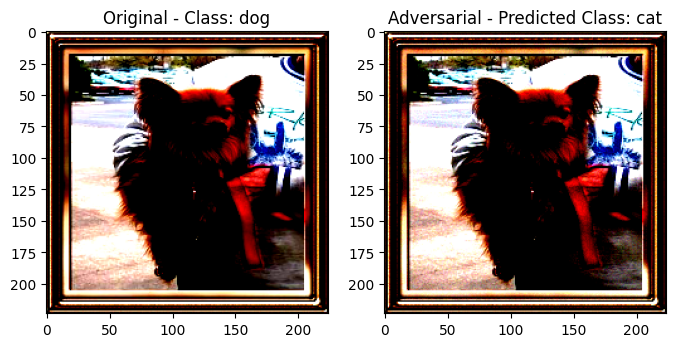

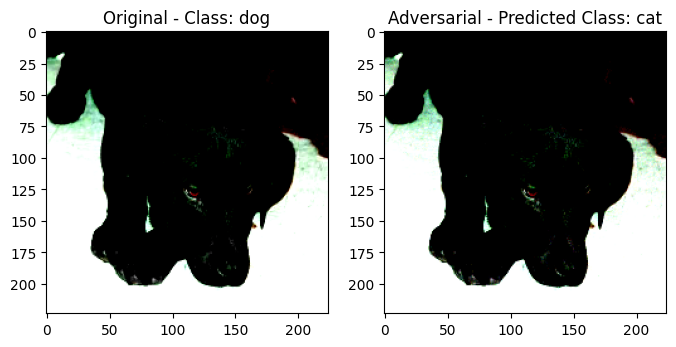

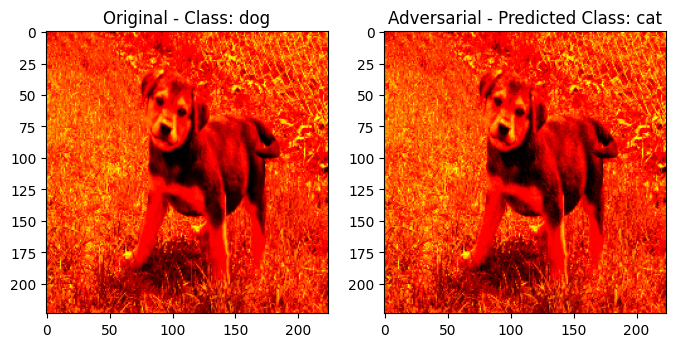

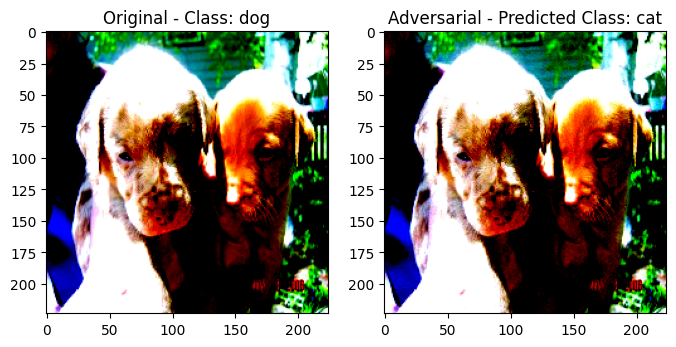

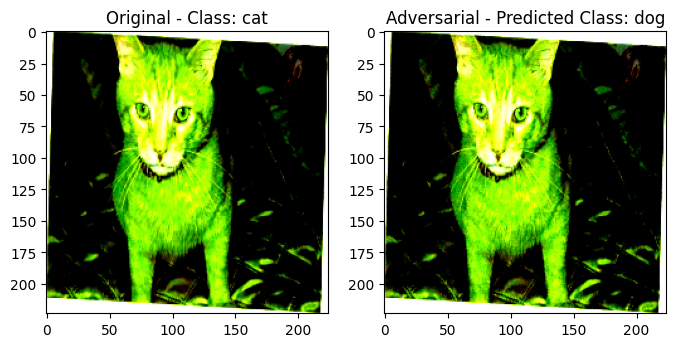

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras import Sequential, layers
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds
from art.attacks.evasion import FastGradientMethod
from art.estimators.classification import TensorFlowV2Classifier
dataset, dataset_info = tfds.load('cats_vs_dogs', split='train', with_info=True, as_supervised=True)
num_classes = 2
def preprocess_image(image, label):
    image = tf.image.resize(image, (224, 224))
    image = tf.image.random_flip_left_right(image)
    image = tf.image.random_brightness(image, max_delta=0.2)
    image = tf.image.random_contrast(image, lower=0.2, upper=1.8)
    image = tf.image.random_hue(image, max_delta=0.1)
    image = tf.image.random_saturation(image, lower=0.2, upper=1.8)
    image = tf.image.per_image_standardization(image)
    label = tf.one_hot(label, num_classes)
    return image, label
dataset = dataset.map(preprocess_image)
num_samples = dataset_info.splits['train'].num_examples
num_train_samples = int(0.8 * num_samples)
num_val_samples = int(0.1 * num_samples)
num_test_samples = num_samples - num_train_samples - num_val_samples
train_dataset = dataset.take(num_train_samples)
remaining_dataset = dataset.skip(num_train_samples)
val_dataset = remaining_dataset.take(num_val_samples)
test_dataset = remaining_dataset.skip(num_val_samples)
batch_size = 32
train_dataset = train_dataset.batch(batch_size)
val_dataset = val_dataset.batch(batch_size)
test_dataset = test_dataset.batch(batch_size)
class_names = dataset_info.features['label'].names
# Build the classification model
model = Sequential([
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    layers.MaxPooling2D(2, 2),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D(2, 2),
    layers.Conv2D(128, (3, 3), activation='relu'),
    layers.MaxPooling2D(2, 2),
    layers.Flatten(),
    layers.Dense(512, activation='relu'),
    layers.Dense(num_classes, activation='softmax')
])

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Training the classification model for 1 epoch
model.fit(train_dataset, epochs=1, validation_data=val_dataset)

# GAN
def build_gan():
    generator = Sequential([
        layers.Dense(256, activation='relu', input_shape=(100,)),
        layers.Reshape((4, 4, 16)),
        layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', activation='relu'),
        layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', activation='relu'),
        layers.Conv2DTranspose(3, (4, 4), strides=(2, 2), padding='same', activation='sigmoid')
    ])

    discriminator = Sequential([
        layers.Conv2D(64, (3, 3), strides=(2, 2), padding='same', activation='relu', input_shape=(224, 224, 3)),
        layers.Conv2D(128, (3, 3), strides=(2, 2), padding='same', activation='relu'),
        layers.Flatten(),
        layers.Dense(1, activation='sigmoid')
    ])

    discriminator.trainable = False
    gan = Sequential([generator, discriminator])
    gan.compile(optimizer='adam', loss='binary_crossentropy')

    return gan

test_batch = next(iter(test_dataset))
test_images, test_labels = test_batch
art_classifier = TensorFlowV2Classifier(
    model=model,
    nb_classes=num_classes,
    input_shape=(224, 224, 3),
    loss_object=tf.keras.losses.CategoricalCrossentropy(),
)
attack = FastGradientMethod(estimator=art_classifier, eps=0.05)
adversarial_test_images = attack.generate(test_images.numpy(), y=test_labels.numpy())
num_adversarial_images = adversarial_test_images.shape[0]
print(f"Number of Adversarial Images: {num_adversarial_images}")
num_display = min(num_adversarial_images, 5)
for i in range(num_display):
    plt.figure(figsize=(8, 4))
    plt.subplot(1, 2, 1)
    plt.imshow(test_images[i])
    plt.title(f'Original - Class: {class_names[np.argmax(test_labels[i].numpy())]}')
    plt.subplot(1, 2, 2)
    plt.imshow(adversarial_test_images[i])
    plt.title(f'Adversarial - Predicted Class: {class_names[np.argmax(art_classifier.predict(adversarial_test_images[i][tf.newaxis, ...]))]}')
    plt.show()
    #Here we are looking at the original class and also the predicted class using GAN and ART which allowed to combine them both together, we are able to see that it is sucessfully confusing the AI model.


Epoch 1/25
1/1 [==============================] - 1s 1s/step - loss: 2.0613 - accuracy: 0.0357 - val_loss: 1.0503 - val_accuracy: 0.5000
Epoch 2/25
1/1 [==============================] - 0s 61ms/step - loss: 1.7208 - accuracy: 0.0357 - val_loss: 1.0028 - val_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 72ms/step - loss: 1.1933 - accuracy: 0.0357 - val_loss: 0.9481 - val_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 57ms/step - loss: 0.8444 - accuracy: 0.3571 - val_loss: 0.9022 - val_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 63ms/step - loss: 0.7234 - accuracy: 0.5714 - val_loss: 0.9041 - val_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 78ms/step - loss: 0.6747 - accuracy: 0.6071 - val_loss: 0.9496 - val_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 65ms/step - loss: 0.6577 - accuracy: 0.5714 - val_loss: 0.9736 - val_accuracy: 0.0000e+00
Epoch 8/2

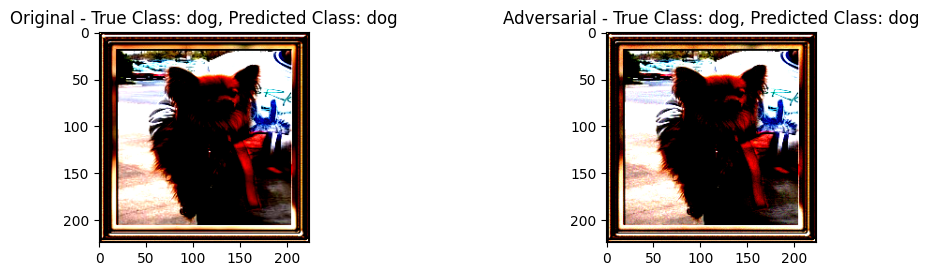

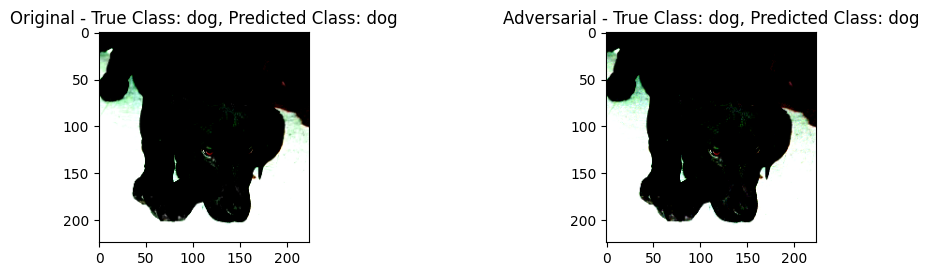

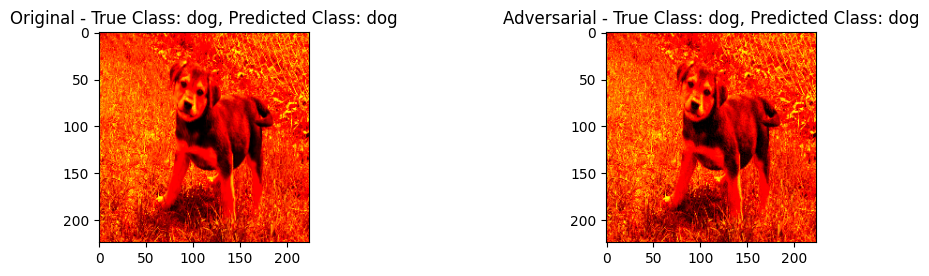

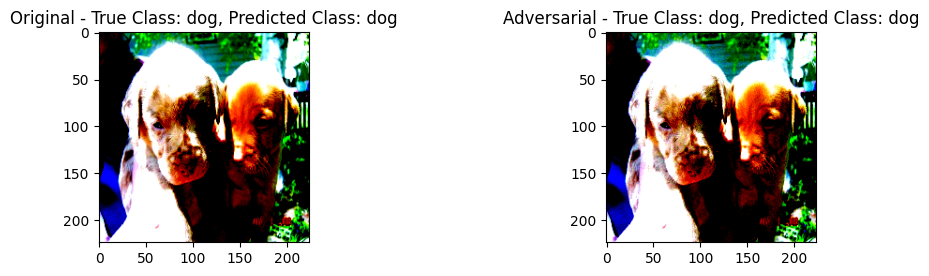

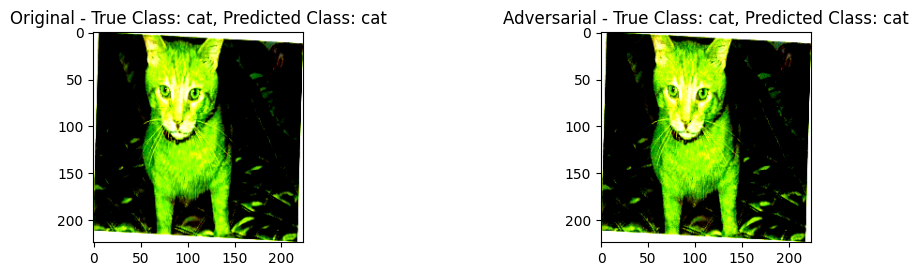

...

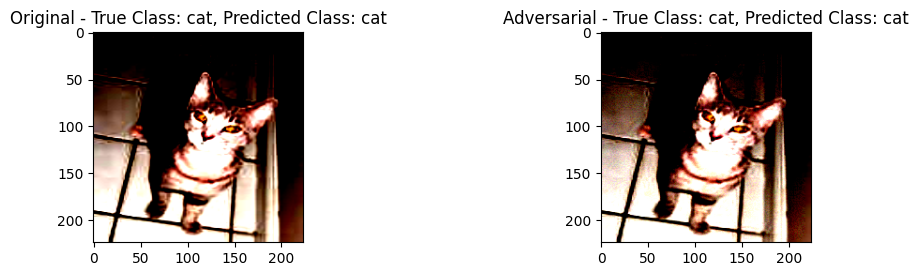

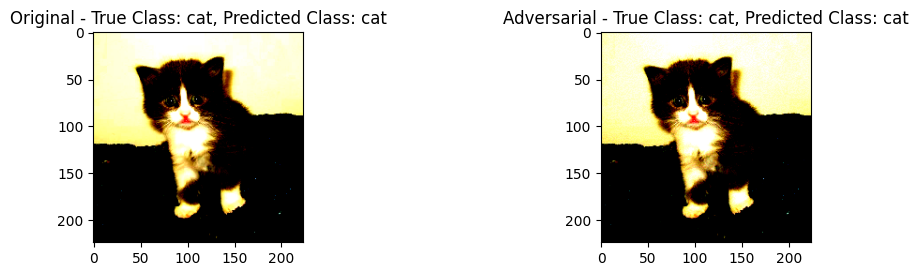

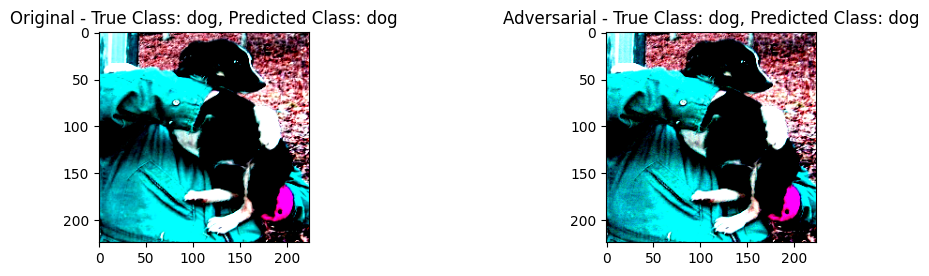

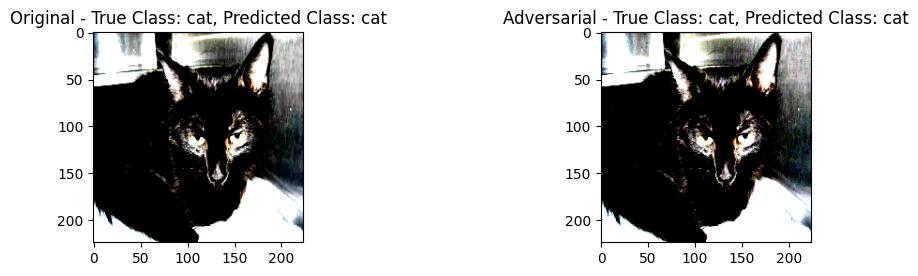

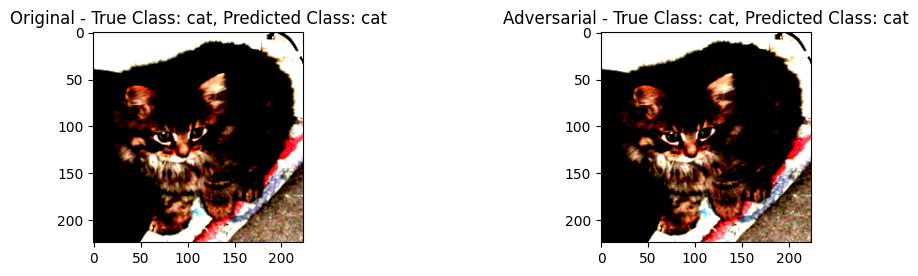

In [ ]:
model.fit(adversarial_test_images, test_labels, epochs=25, batch_size=batch_size, validation_split=0.1)
loss, accuracy = model.evaluate(adversarial_test_images, test_labels)
print(f'Retrained Model - Loss: {loss}, Accuracy: {accuracy}')
original_predictions = model.predict(test_images)
adversarial_predictions = model.predict(adversarial_test_images)
num_display = min(num_adversarial_images, 25)
for i in range(num_display):
    plt.figure(figsize=(12, 6))
    plt.subplot(2, 2, 1)
    plt.imshow(test_images[i])
    plt.title(f'Original - True Class: {class_names[np.argmax(test_labels[i].numpy())]}, Predicted Class: {class_names[np.argmax(original_predictions[i])]}')
    plt.subplot(2, 2, 2)
    plt.imshow(adversarial_test_images[i])
    plt.title(f'Adversarial - True Class: {class_names[np.argmax(test_labels[i].numpy())]}, Predicted Class: {class_names[np.argmax(adversarial_predictions[i])]}')

    plt.show()


Number of Adversarial Images: 32
Adversarial Test Accuracy: 3.12%


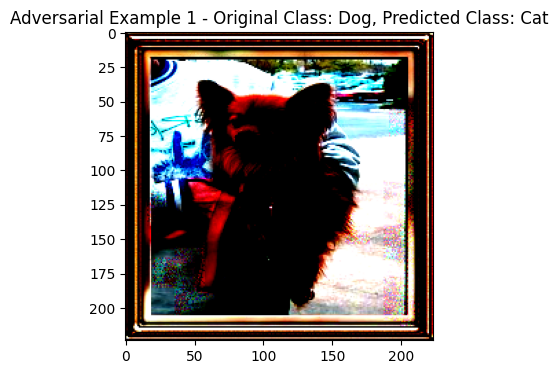

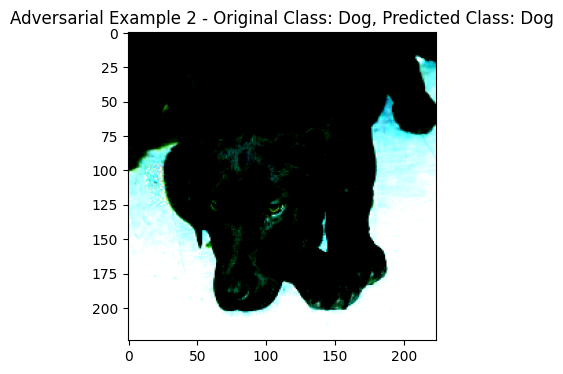

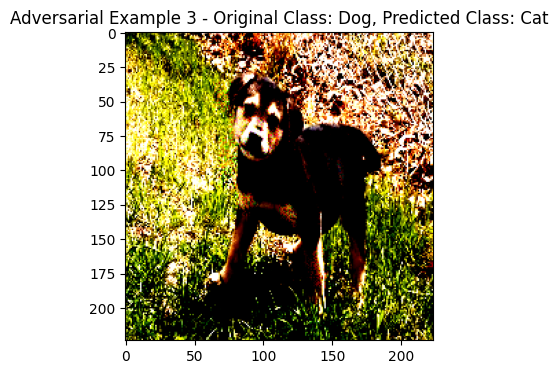

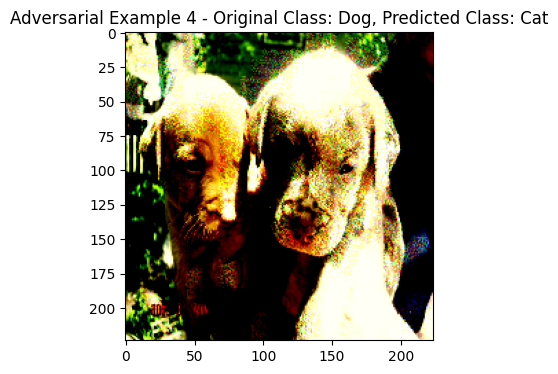

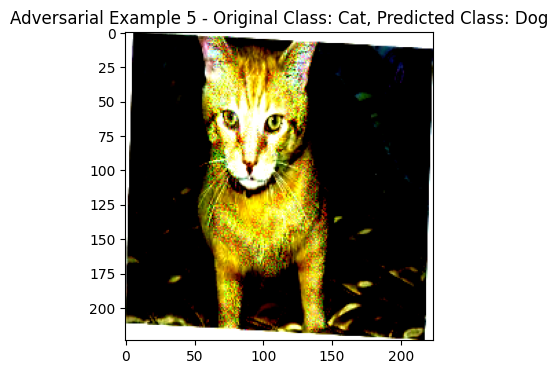

...

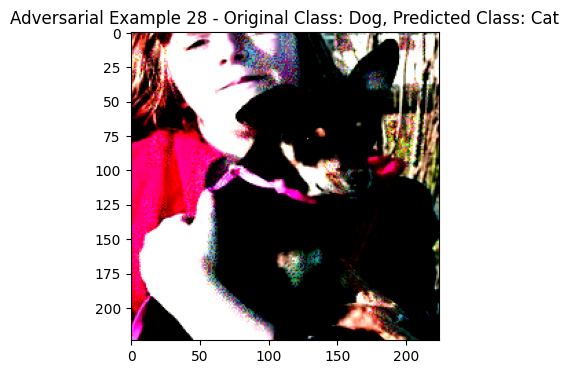

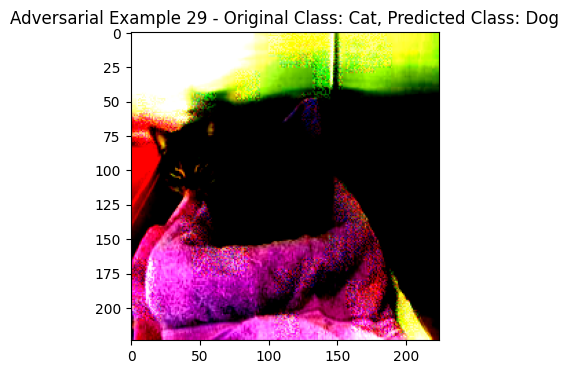

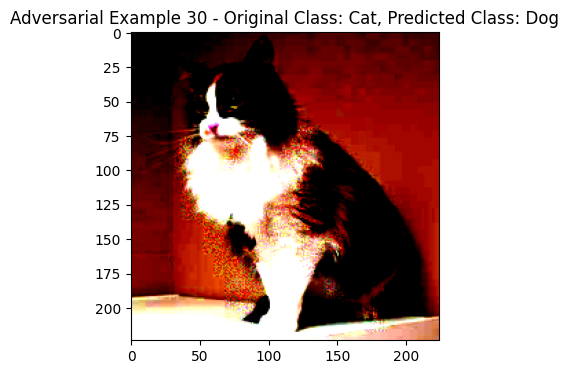

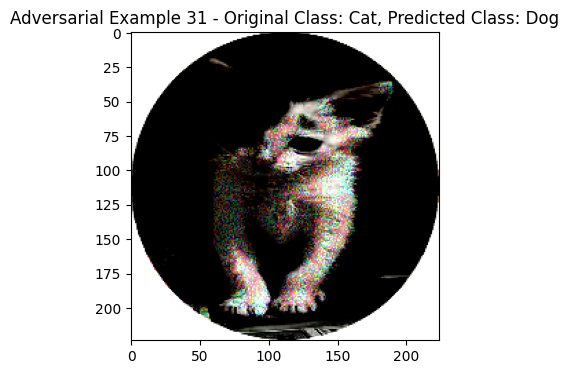

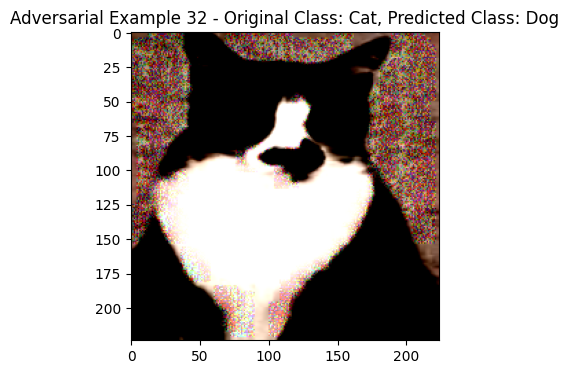

In [ ]:
test_batch = next(iter(test_dataset))
test_images, test_labels = test_batch

art_classifier = TensorFlowV2Classifier(
    model=model,
    nb_classes=num_classes,
    input_shape=(224, 224, 3),
    loss_object=tf.keras.losses.CategoricalCrossentropy(),
)

attack = FastGradientMethod(estimator=art_classifier, eps=0.2)

adversarial_test_images = attack.generate(test_images.numpy(), y=test_labels.numpy())

original_class_names = ['Dog' if label[1] == 1 else 'Cat' for label in test_labels.numpy()]

adversarial_test_probs = art_classifier.predict(adversarial_test_images)
adversarial_test_labels = np.argmax(adversarial_test_probs, axis=1)
adversarial_test_class_names = ['Dog' if label == 1 else 'Cat' for label in adversarial_test_labels]

adversarial_test_acc = np.sum(adversarial_test_labels == np.argmax(test_labels, axis=1)) / len(test_labels)

num_adversarial_images = adversarial_test_images.shape[0]
print(f"Number of Adversarial Images: {num_adversarial_images}")
print(f"Adversarial Test Accuracy: {adversarial_test_acc * 100:.2f}%")

num_display = min(num_adversarial_images, 35)
for i in range(num_display):
    plt.figure(figsize=(8, 4))
    plt.imshow(adversarial_test_images[i])
    plt.title(f'Adversarial Example {i + 1} - Original Class: {original_class_names[i]}, Predicted Class: {adversarial_test_class_names[i]}')
    plt.show()
  #Here we are looking at the original class and also the predicted class using GAN and ART which allowed to combine them both together, we are able to see that it is sucessfully confusing the AI model.
#We are able to see that the ART Library and GAn is confusing the AI model succesfully.